In [3]:
pip install scikit-image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.9/14.9 MB 334.6 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 315.4/315.4 kB 409.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.2/228.2 kB 407.8 MB/s eta 0:00:00

[notice] A new release of pip is available: 23.1.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [1]:
%matplotlib inline
import torch

from PIL import Image
import numpy as np

import cv2
import matplotlib.pyplot as plt
from torchray.attribution.grad_cam import grad_cam as tr_gradcam

import torch.nn.functional as F
import torch.nn as nn
import torchvision
from torchvision import transforms
import PIL
from omegaconf import OmegaConf
from tqdm import tqdm

import os
if os.getcwd().split(os.sep)[-1] == 'notebooks':
    os.chdir('..')
print(os.getcwd())

import matplotlib
matplotlib.rcParams.update({'font.size': 18})

from utils.rise import RISE
from models.resnet import resnet18, resnet50
import utils.general_utils as gu
from datasets import normalizations
import datasets

/mimer/NOBACKUP/groups/ulio_inverse/ds-project/GALS


In [2]:
import torch
print(torch.cuda.is_available())  # Should return True
print(torch.cuda.device_count())  # Number of GPUs available


True
4


In [3]:
def load_checkpoint(checkpoint_file, net):
    checkpoint = torch.load(checkpoint_file, map_location='cpu')
    state_dict = gu.check_module_state_dict(checkpoint['model_state_dict'])
    net.load_state_dict(state_dict)
    print('Loaded checkpoint {}'.format(checkpoint_file))

    
    
    
def plot(numpy_image, label_float, prob_float, attention, label_mapping=None, save_path=None):
    if label_mapping is not None:
        cls = label_mapping[int(label_float)]
    else:
        cls = 'Class {}'.format(int(label_float))

    fig, ax = plt.subplots(1,2, figsize=(5,6))
    ax[0].imshow(numpy_image)
    ax[0].axis('off')

    ax[1].imshow(numpy_image)
    ax[1].imshow(attention, alpha=0.4, cmap='jet')
    ax[1].axis('off')
    ax[1].set_title('{}: {:.3f}'.format(cls, prob_float),
                    fontsize=14)

    plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, bbox_inches='tight')
    else:
        plt.show()
    return



class RISENet(nn.Module):
    def __init__(self, net, num_classifier_classes=1):
        super(RISENet, self).__init__()
        self.net = net
        self.num_classifier_classes = num_classifier_classes
        
        if num_classifier_classes == 1:
            self.activation = nn.Sigmoid()
        else:
            self.activation = nn.Softmax(dim=1)
        
    def forward(self, inputs):
        logits = self.net(inputs)
        probs, _, _ = gu.calc_preds(logits, self.activation, self.num_classifier_classes)
        return probs
    



In [34]:
config_file = 'configs/coco_gals.yaml'
cfg       = OmegaConf.load(config_file)
base_cfg  = OmegaConf.load('configs/base.yaml')
args      = OmegaConf.merge(base_cfg, cfg)

size = args.DATA.SIZE

device = 'cuda:2'
model_type = args.EXP.MODEL


In [35]:
# Just a sample
checkpoint = './wandb/coco_gender/wandb/run-20241127_152732-coco_train_median_27.11/files/best_valacc_0.71_epoch_18.ckpt'
num_classifier_classes = 3
num_classes = 3

if model_type == 'resnet50':
    net = resnet50(pretrained=False, num_classes = num_classifier_classes)
else:
    net = resnet18(pretrained=False, num_classes = num_classifier_classes)
    
    
#net.to(device)
os.environ['CUDA_VISIBLE_DEVICES'] = ''
load_checkpoint(checkpoint, net)

# Add activation
net = RISENet(net, num_classifier_classes)
net.to(device)
net.eval()
    

Loaded checkpoint ./wandb/coco_gender/wandb/run-20241127_152732-coco_train_median_27.11/files/best_valacc_0.71_epoch_18.ckpt


RISENet(
  (net): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0):

In [23]:
device = 'cuda:2'
net = resnet50(pretrained=True)
    
#net.to(device)
#os.environ['CUDA_VISIBLE_DEVICES'] = '2'

# Add activation
num_classifier_classes = 1000
num_classes = 1000
size = 224

net = RISENet(net, num_classifier_classes)
net.to(device)
net.eval()

RISENet(
  (net): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0):

In [36]:
# ***** Set dataset *****
dataset_type = args.DATA.DATASET
print(dataset_type)
if dataset_type == 'waterbirds':
    from datasets.waterbirds import Waterbirds as Dataset
    label_mapping = datasets.waterbirds.get_label_mapping()
elif dataset_type == 'coco_gender':
    from datasets.coco import COCOGender as Dataset
    label_mapping = datasets.coco.get_label_mapping()
elif dataset_type == 'coco_device':
    from datasets.coco_device import COCODevice as Dataset
else:
    raise NotImplementedError

mean, std = normalizations.normalizations['imagenet']['mean'], \
            normalizations.normalizations['imagenet']['std']
transform = transforms.Compose([
    transforms.Resize((size, size)),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

test_dataset = Dataset(root='./data',
                       cfg=args,
                       transform=transform,
                       split='test')

test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                              batch_size=1,
                                              num_workers=args.DATA.NUM_WORKERS,
                                              shuffle=False)




coco_gender
loading annotations into memory...
Done (t=5.23s)
creating index...
index created!
TEST STATS:
NUM MAN:    188
NUM WOMAN:  188
NUM PERSON: 0


In [37]:
# RISE setup
rise = RISE(net,
            (size, size),
            num_classes=num_classes,
            gpu_batch=16,
            p1=0.1)
# Generate masks for RISE or use the saved ones.
maskspath = 'masks.npy'
generate_new = True
rise_N = 100
rise_s = 8
if generate_new or not os.path.isfile(maskspath):
    rise.generate_masks(N=rise_N, s=rise_s, device=device, savepath=maskspath)
else:
    rise.load_masks(maskspath, device)
    print('Masks are loaded.')
name = 'rise_N_{}_s_{}'.format(rise_N, rise_s)# if generate_new else 'rise_used_old_masks'



Generating filters: 100%|████████████████████████████████████████████████████████| 100/100 [00:00<00:00, 467.45it/s]


In [31]:
def explain_all(images, labels, explainer):
    total = len(labels)
    probs, classpreds = torch.sort(nn.Softmax(1)(explainer(images)), dim=1, descending=True)
    explanations = []
    for img in images:
        explanations.append(explainer(torch.unsqueeze(img, 0)))
    return explanations, probs, classpreds

  0%|                                                                                       | 0/376 [00:00<?, ?it/s]

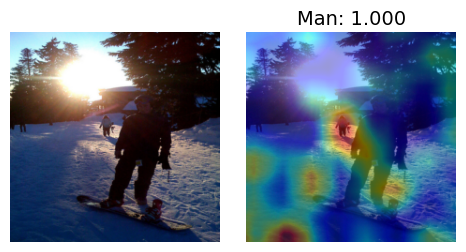

  0%|▏                                                                              | 1/376 [00:00<05:24,  1.15it/s]

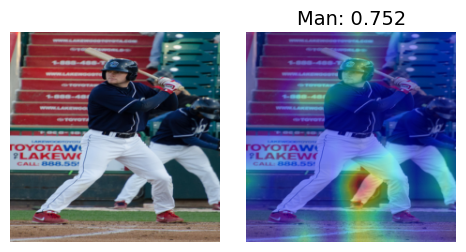

  1%|▍                                                                              | 2/376 [00:01<03:50,  1.62it/s]

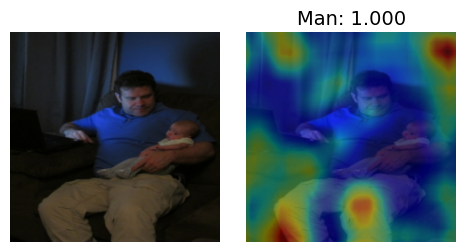

  1%|▋                                                                              | 3/376 [00:01<03:21,  1.85it/s]

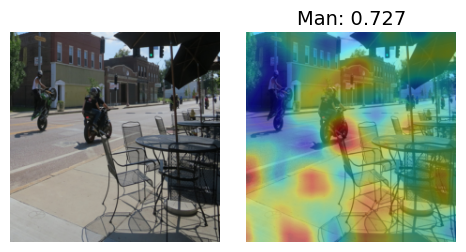

  1%|▊                                                                              | 4/376 [00:02<03:06,  2.00it/s]

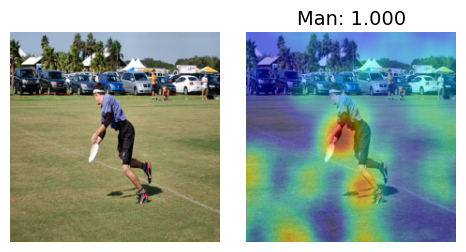

  1%|█                                                                              | 5/376 [00:02<02:57,  2.09it/s]

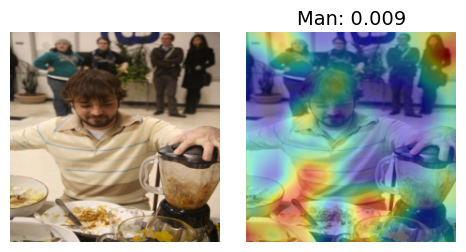

  2%|█▎                                                                             | 6/376 [00:03<02:51,  2.15it/s]

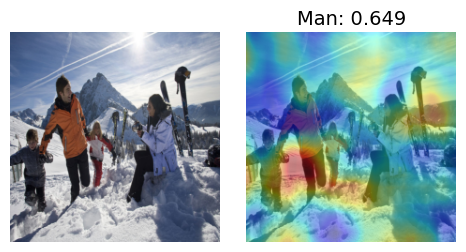

  2%|█▍                                                                             | 7/376 [00:03<02:47,  2.20it/s]

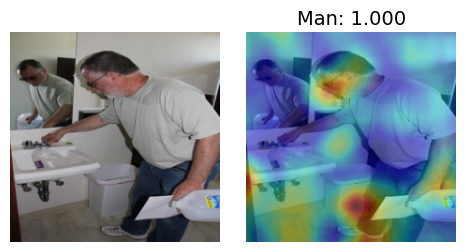

  2%|█▋                                                                             | 8/376 [00:03<02:45,  2.23it/s]

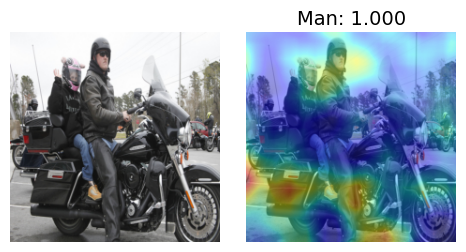

  2%|█▉                                                                             | 9/376 [00:04<02:41,  2.28it/s]

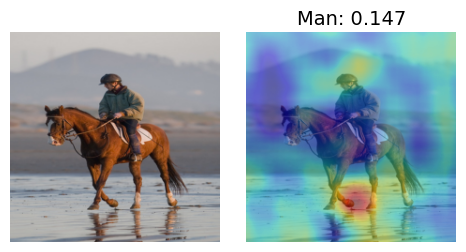

  3%|██                                                                            | 10/376 [00:04<02:38,  2.30it/s]

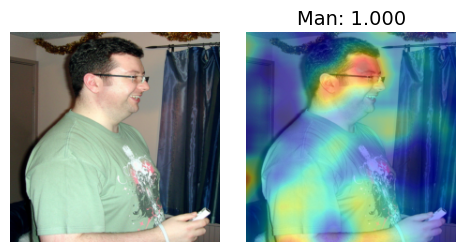

  3%|██▎                                                                           | 11/376 [00:05<02:40,  2.27it/s]

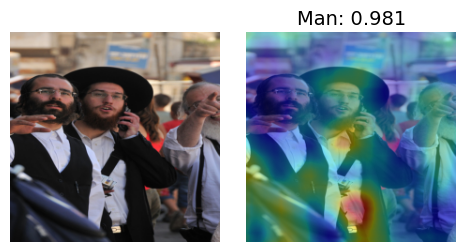

  3%|██▍                                                                           | 12/376 [00:05<02:40,  2.26it/s]

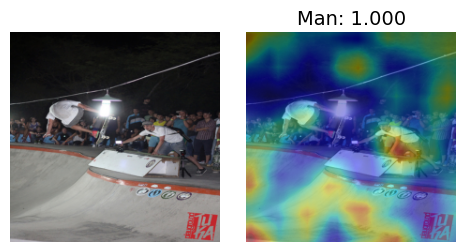

  3%|██▋                                                                           | 13/376 [00:06<02:41,  2.25it/s]

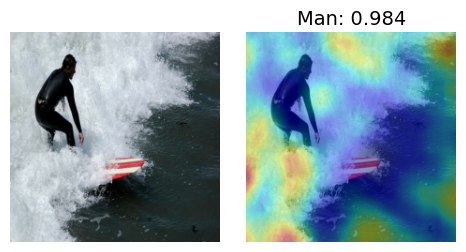

  4%|██▉                                                                           | 14/376 [00:06<02:39,  2.27it/s]

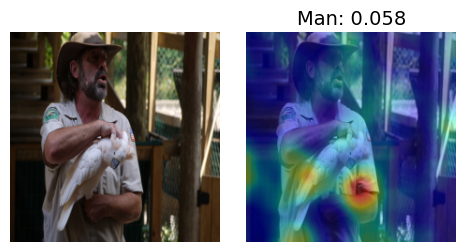

  4%|███                                                                           | 15/376 [00:07<02:38,  2.27it/s]

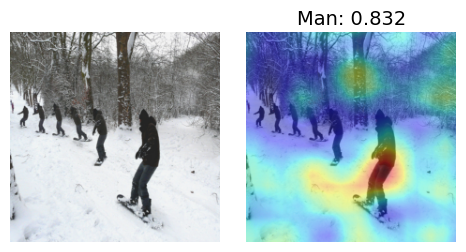

  4%|███▎                                                                          | 16/376 [00:07<02:37,  2.29it/s]

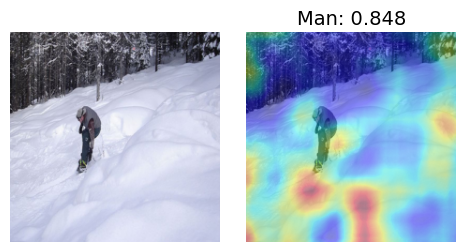

  5%|███▌                                                                          | 17/376 [00:07<02:36,  2.29it/s]

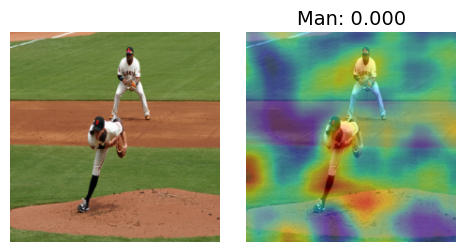

  5%|███▋                                                                          | 18/376 [00:08<02:36,  2.28it/s]

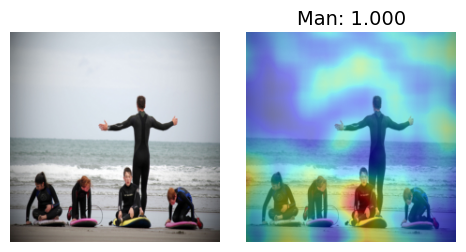

  5%|███▉                                                                          | 19/376 [00:08<02:36,  2.29it/s]

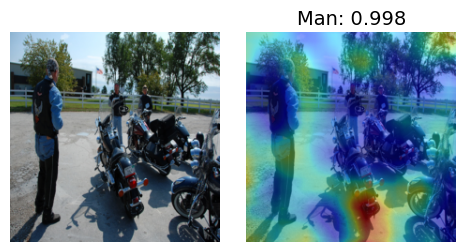

  5%|████▏                                                                         | 20/376 [00:09<02:35,  2.29it/s]

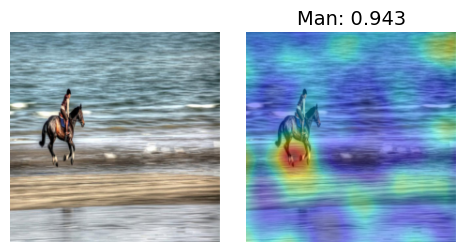

  6%|████▎                                                                         | 21/376 [00:09<02:35,  2.28it/s]

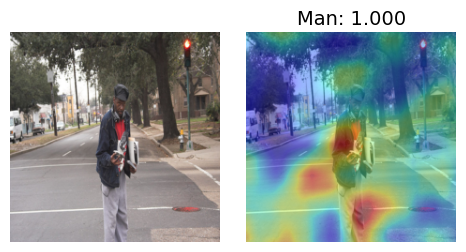

  6%|████▌                                                                         | 22/376 [00:10<02:35,  2.28it/s]

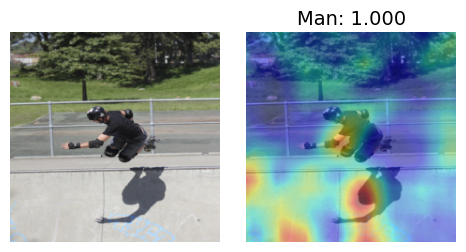

  6%|████▊                                                                         | 23/376 [00:10<02:35,  2.27it/s]

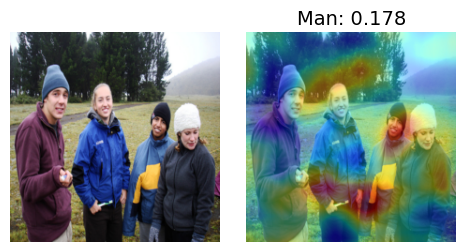

  6%|████▉                                                                         | 24/376 [00:10<02:34,  2.28it/s]

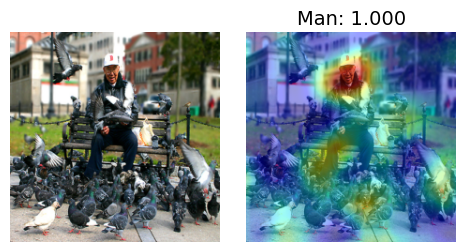

  7%|█████▏                                                                        | 25/376 [00:11<02:33,  2.29it/s]

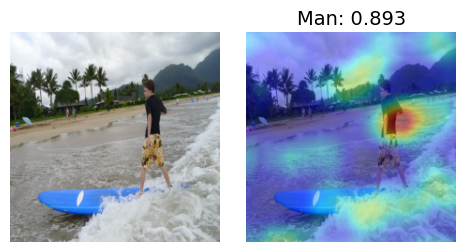

  7%|█████▍                                                                        | 26/376 [00:11<02:33,  2.29it/s]

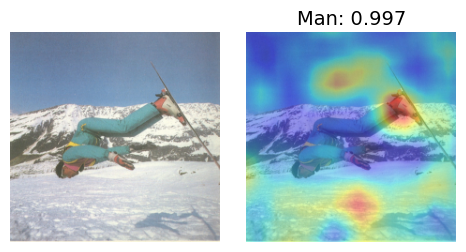

  7%|█████▌                                                                        | 27/376 [00:12<02:34,  2.26it/s]

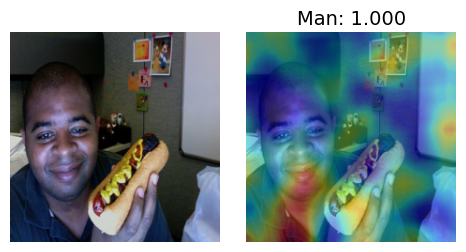

  7%|█████▊                                                                        | 28/376 [00:12<02:34,  2.25it/s]

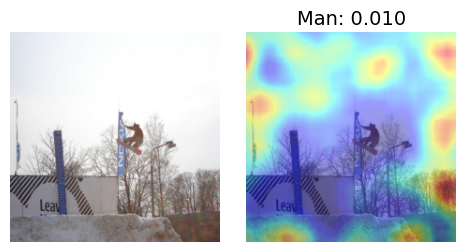

  8%|██████                                                                        | 29/376 [00:13<02:31,  2.28it/s]

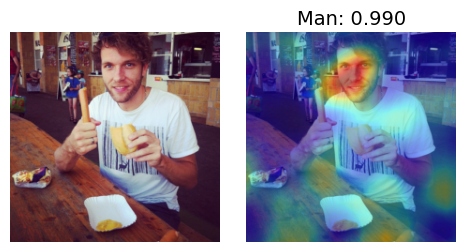

  8%|██████▏                                                                       | 30/376 [00:13<02:32,  2.27it/s]

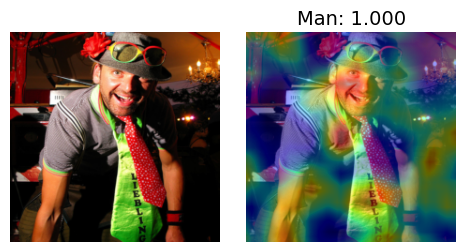

  8%|██████▍                                                                       | 31/376 [00:14<02:31,  2.28it/s]

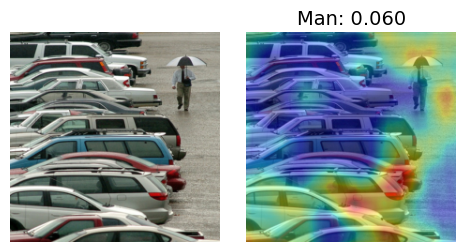

  9%|██████▋                                                                       | 32/376 [00:14<02:30,  2.29it/s]

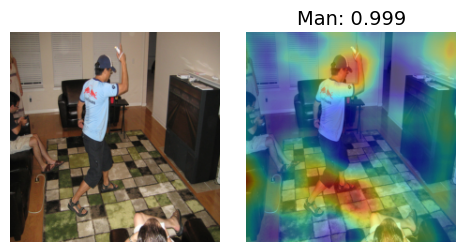

  9%|██████▊                                                                       | 33/376 [00:14<02:29,  2.30it/s]

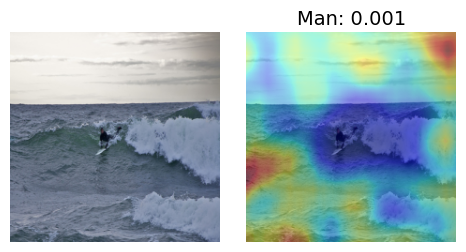

  9%|███████                                                                       | 34/376 [00:15<02:28,  2.31it/s]

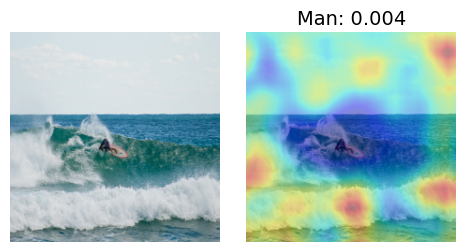

  9%|███████▎                                                                      | 35/376 [00:15<02:28,  2.30it/s]

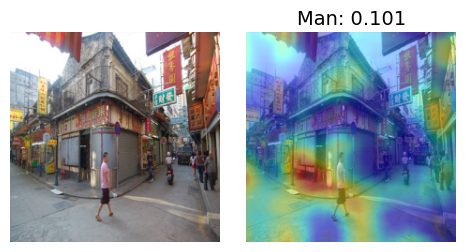

 10%|███████▍                                                                      | 36/376 [00:16<02:28,  2.29it/s]

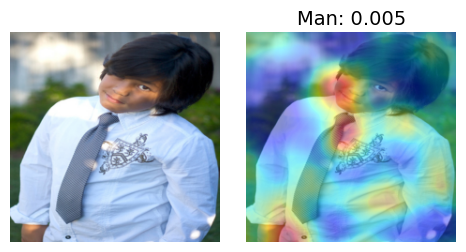

 10%|███████▋                                                                      | 37/376 [00:16<02:28,  2.28it/s]

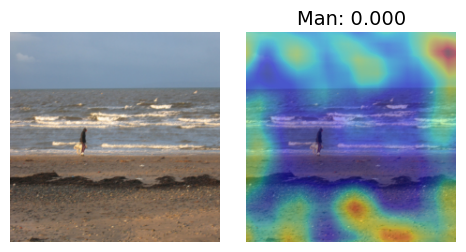

 10%|███████▉                                                                      | 38/376 [00:17<02:28,  2.28it/s]

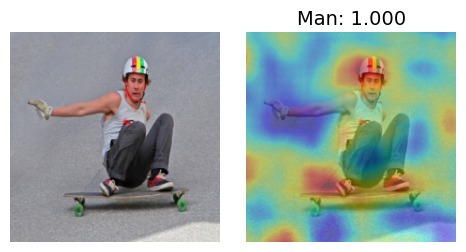

 10%|████████                                                                      | 39/376 [00:17<02:28,  2.26it/s]

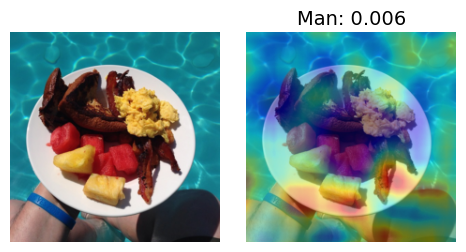

 11%|████████▎                                                                     | 40/376 [00:17<02:28,  2.26it/s]

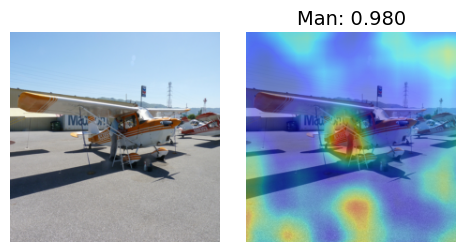

 11%|████████▌                                                                     | 41/376 [00:18<02:28,  2.26it/s]

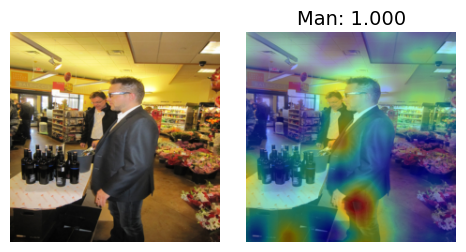

 11%|████████▋                                                                     | 42/376 [00:18<02:27,  2.26it/s]

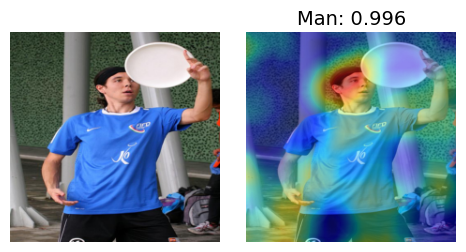

 11%|████████▉                                                                     | 43/376 [00:19<02:29,  2.22it/s]

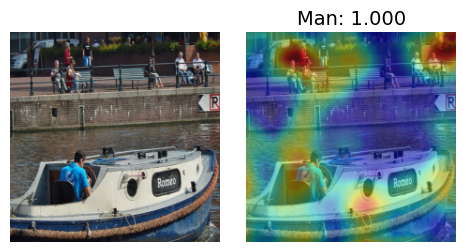

 12%|█████████▏                                                                    | 44/376 [00:19<02:29,  2.22it/s]

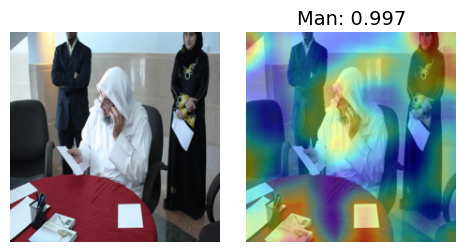

 12%|█████████▎                                                                    | 45/376 [00:20<02:29,  2.22it/s]

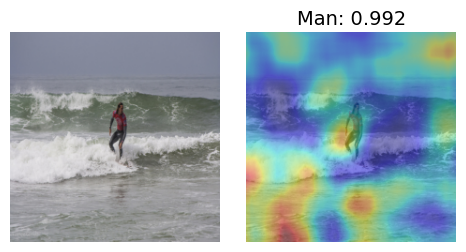

 12%|█████████▌                                                                    | 46/376 [00:20<02:28,  2.23it/s]

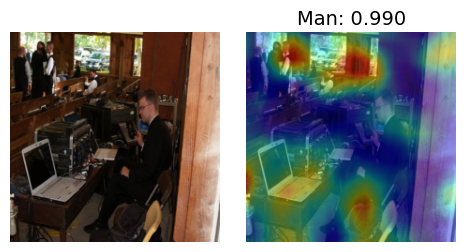

 12%|█████████▊                                                                    | 47/376 [00:21<02:27,  2.23it/s]

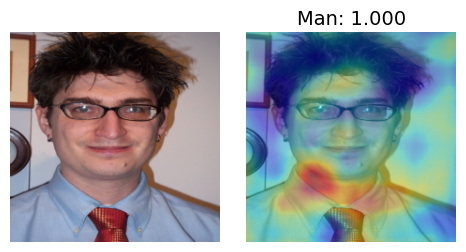

 13%|█████████▉                                                                    | 48/376 [00:21<02:27,  2.22it/s]

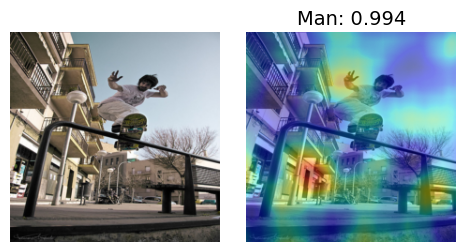

 13%|██████████▏                                                                   | 49/376 [00:22<02:25,  2.25it/s]

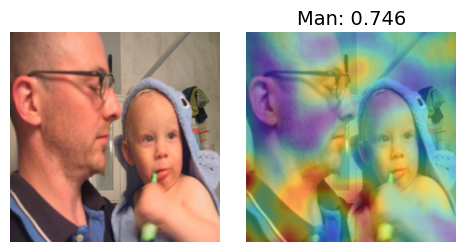

 13%|██████████▎                                                                   | 50/376 [00:22<02:25,  2.24it/s]

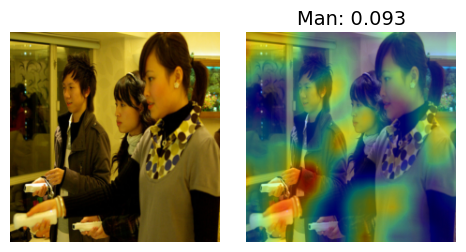

 14%|██████████▌                                                                   | 51/376 [00:22<02:24,  2.24it/s]

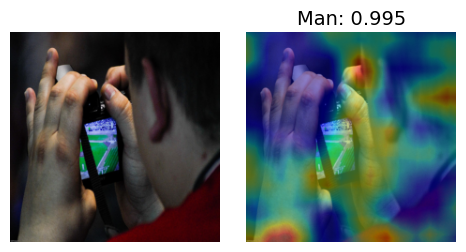

 14%|██████████▊                                                                   | 52/376 [00:23<02:24,  2.24it/s]

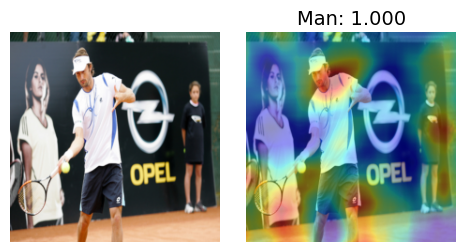

 14%|██████████▉                                                                   | 53/376 [00:23<02:24,  2.24it/s]

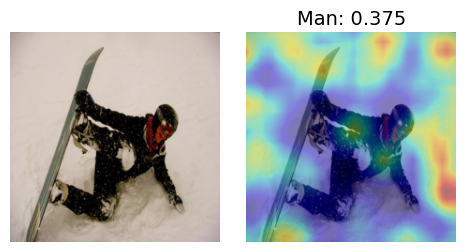

 14%|███████████▏                                                                  | 54/376 [00:24<02:24,  2.23it/s]

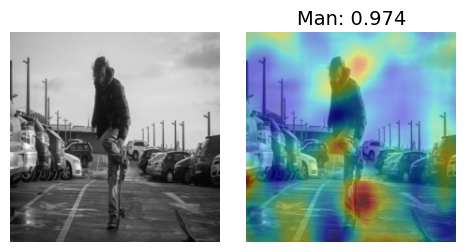

 15%|███████████▍                                                                  | 55/376 [00:24<02:23,  2.24it/s]

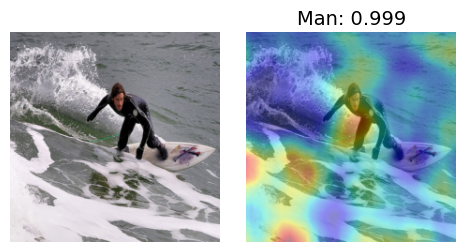

 15%|███████████▌                                                                  | 56/376 [00:25<02:23,  2.23it/s]

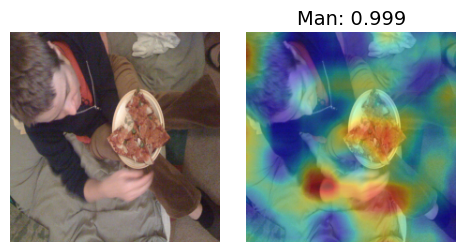

 15%|███████████▊                                                                  | 57/376 [00:25<02:22,  2.23it/s]

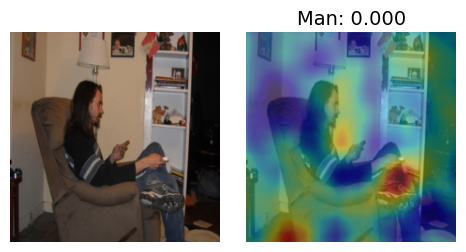

 15%|████████████                                                                  | 58/376 [00:26<02:22,  2.24it/s]

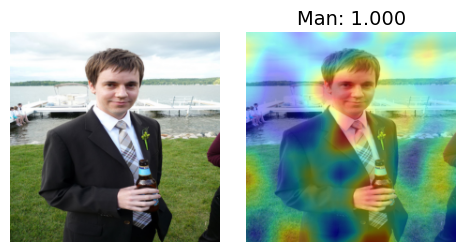

 16%|████████████▏                                                                 | 59/376 [00:26<02:21,  2.25it/s]

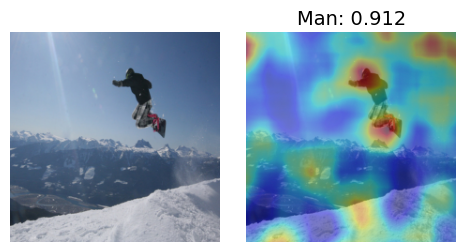

 16%|████████████▍                                                                 | 60/376 [00:26<02:20,  2.25it/s]

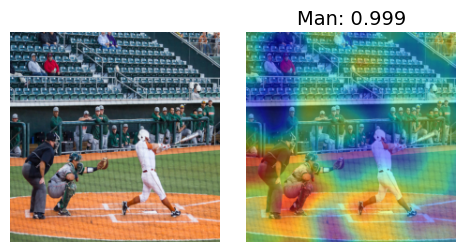

 16%|████████████▋                                                                 | 61/376 [00:27<02:20,  2.25it/s]

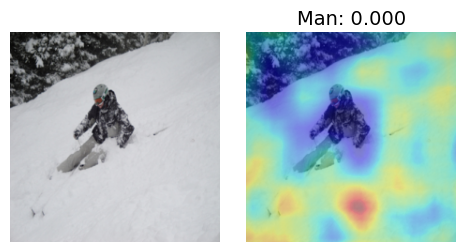

 16%|████████████▊                                                                 | 62/376 [00:27<02:19,  2.24it/s]

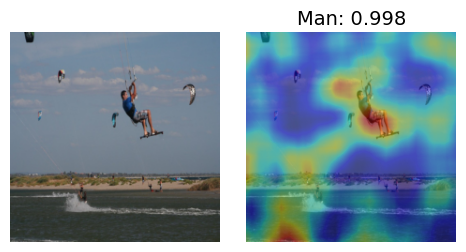

 17%|█████████████                                                                 | 63/376 [00:28<02:19,  2.25it/s]

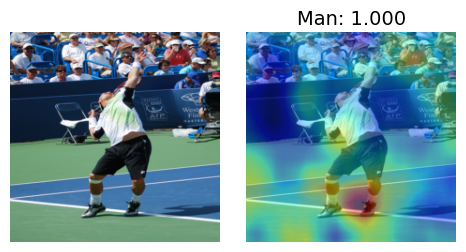

 17%|█████████████▎                                                                | 64/376 [00:28<02:18,  2.25it/s]

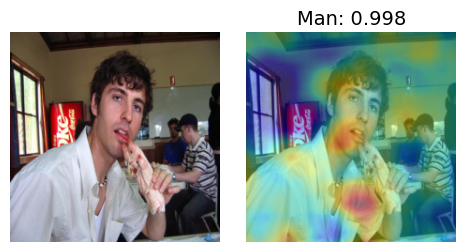

 17%|█████████████▍                                                                | 65/376 [00:29<03:04,  1.68it/s]

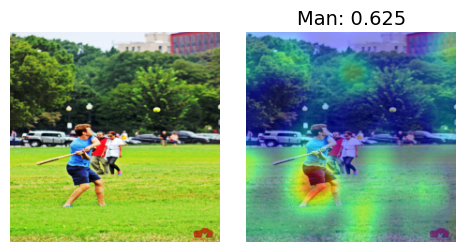

 18%|█████████████▋                                                                | 66/376 [00:30<02:50,  1.82it/s]

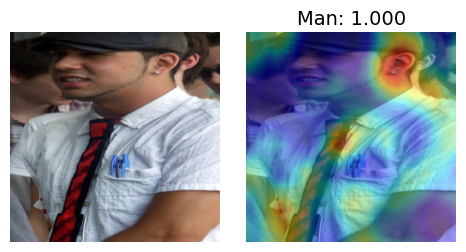

 18%|█████████████▉                                                                | 67/376 [00:30<02:40,  1.92it/s]

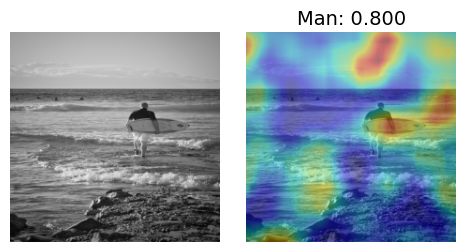

 18%|██████████████                                                                | 68/376 [00:30<02:31,  2.03it/s]

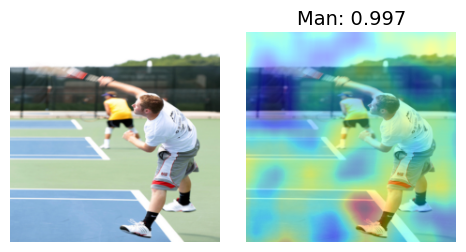

 18%|██████████████▎                                                               | 69/376 [00:31<02:26,  2.10it/s]

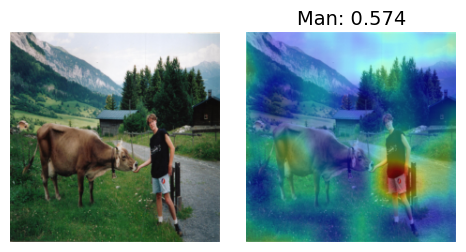

 19%|██████████████▌                                                               | 70/376 [00:31<02:23,  2.13it/s]

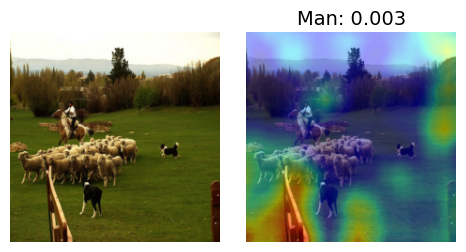

 19%|██████████████▋                                                               | 71/376 [00:32<02:21,  2.16it/s]

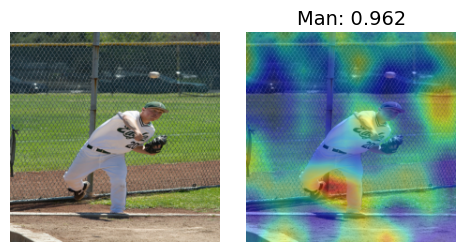

 19%|██████████████▉                                                               | 72/376 [00:32<02:18,  2.20it/s]

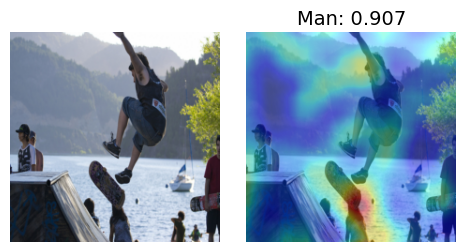

 19%|███████████████▏                                                              | 73/376 [00:33<02:16,  2.21it/s]

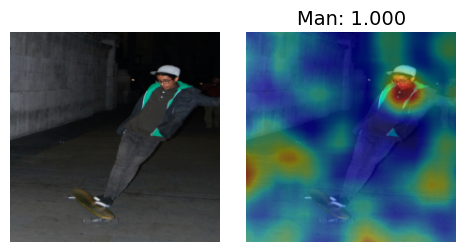

 20%|███████████████▎                                                              | 74/376 [00:33<02:15,  2.23it/s]

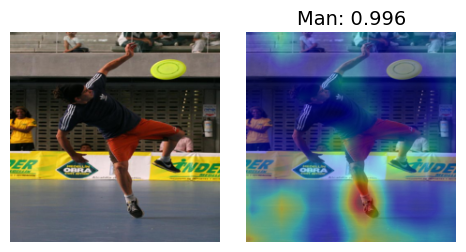

 20%|███████████████▌                                                              | 75/376 [00:34<02:13,  2.25it/s]

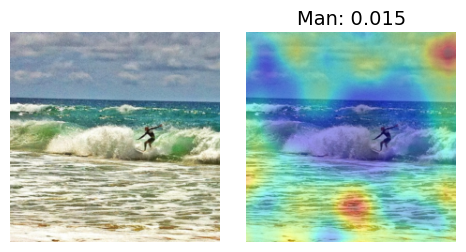

 20%|███████████████▊                                                              | 76/376 [00:34<02:13,  2.24it/s]

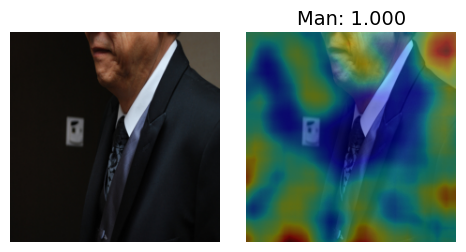

 20%|███████████████▉                                                              | 77/376 [00:34<02:13,  2.24it/s]

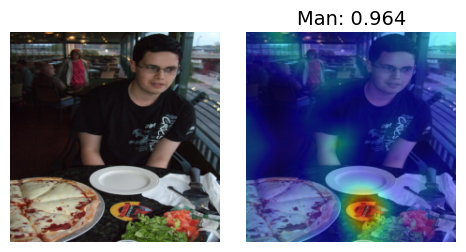

 21%|████████████████▏                                                             | 78/376 [00:35<02:13,  2.24it/s]

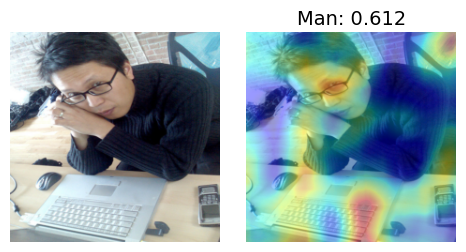

 21%|████████████████▍                                                             | 79/376 [00:35<02:12,  2.24it/s]

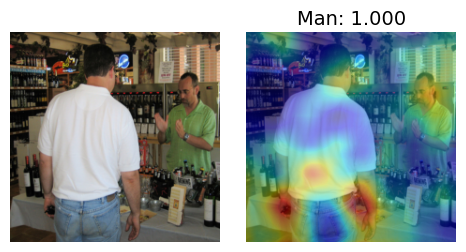

 21%|████████████████▌                                                             | 80/376 [00:36<02:12,  2.23it/s]

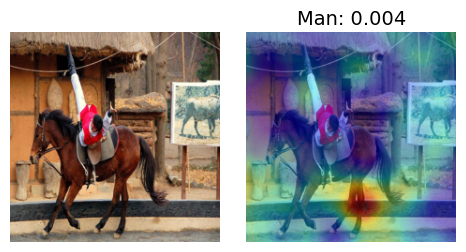

 22%|████████████████▊                                                             | 81/376 [00:36<02:11,  2.24it/s]

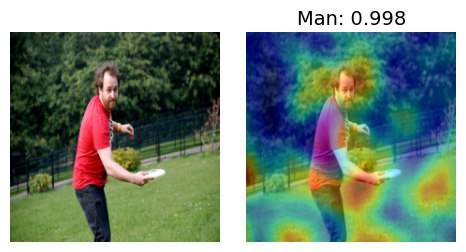

 22%|█████████████████                                                             | 82/376 [00:37<02:11,  2.24it/s]

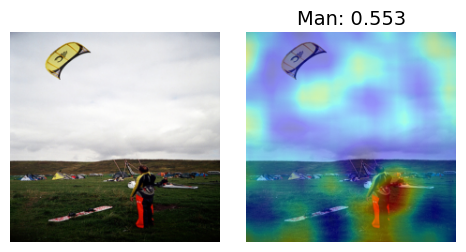

 22%|█████████████████▏                                                            | 83/376 [00:37<02:11,  2.23it/s]

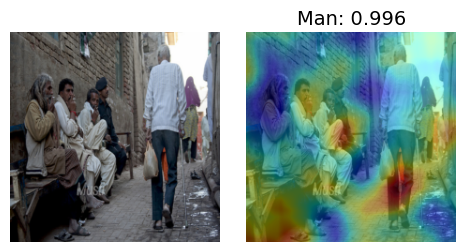

 22%|█████████████████▍                                                            | 84/376 [00:38<02:10,  2.24it/s]

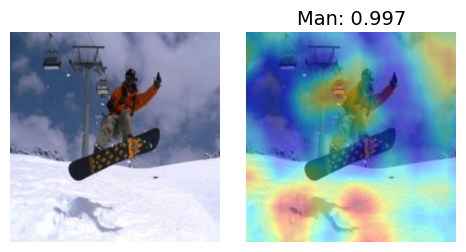

 23%|█████████████████▋                                                            | 85/376 [00:38<02:10,  2.24it/s]

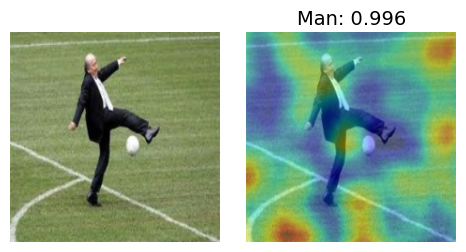

 23%|█████████████████▊                                                            | 86/376 [00:38<02:09,  2.24it/s]

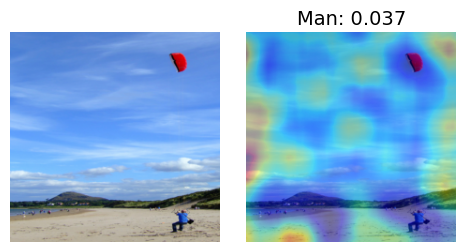

 23%|██████████████████                                                            | 87/376 [00:39<02:09,  2.23it/s]

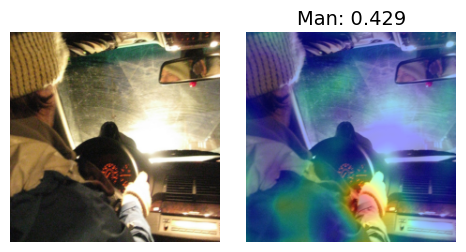

 23%|██████████████████▎                                                           | 88/376 [00:39<02:09,  2.23it/s]

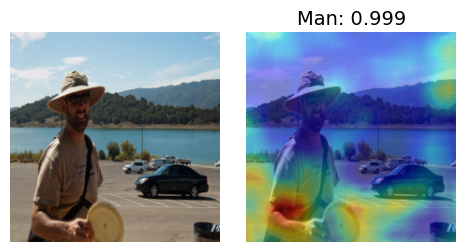

 24%|██████████████████▍                                                           | 89/376 [00:40<02:09,  2.22it/s]

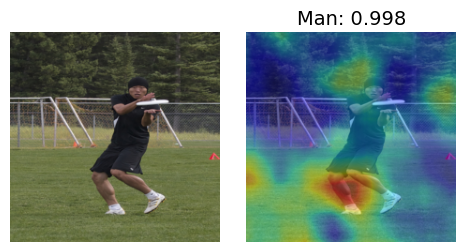

 24%|██████████████████▋                                                           | 90/376 [00:40<02:08,  2.22it/s]

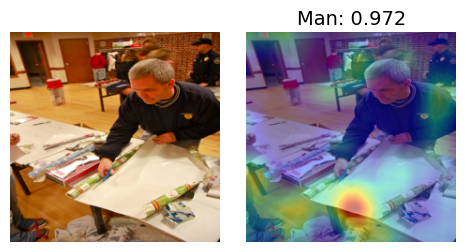

 24%|██████████████████▉                                                           | 91/376 [00:41<02:08,  2.22it/s]

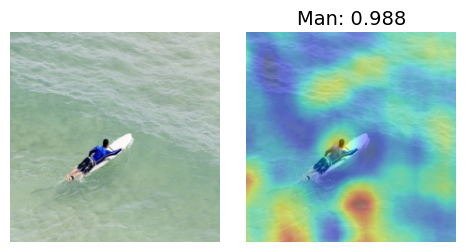

 24%|███████████████████                                                           | 92/376 [00:41<02:08,  2.21it/s]

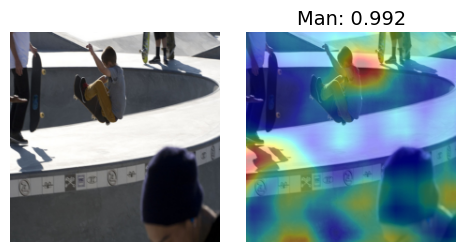

 25%|███████████████████▎                                                          | 93/376 [00:42<02:06,  2.23it/s]

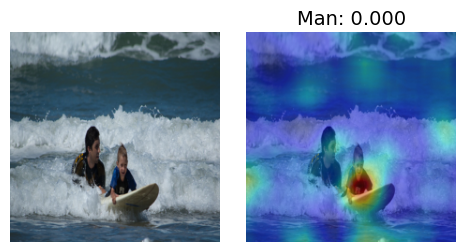

 25%|███████████████████▌                                                          | 94/376 [00:42<02:06,  2.23it/s]

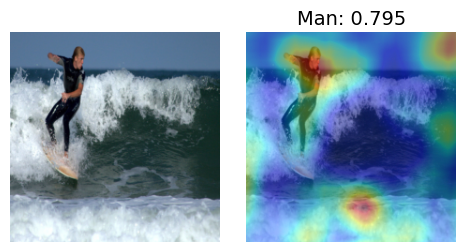

 25%|███████████████████▋                                                          | 95/376 [00:43<02:06,  2.23it/s]

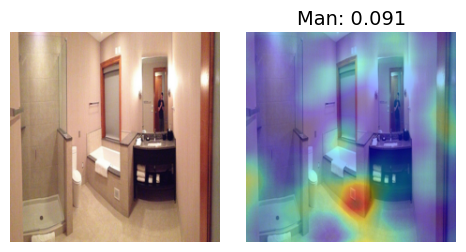

 26%|███████████████████▉                                                          | 96/376 [00:43<02:05,  2.22it/s]

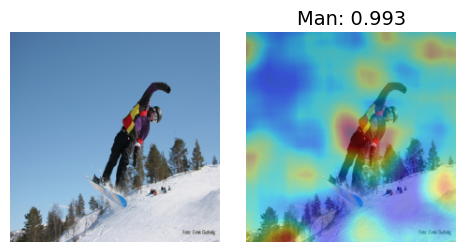

 26%|████████████████████                                                          | 97/376 [00:43<02:04,  2.24it/s]

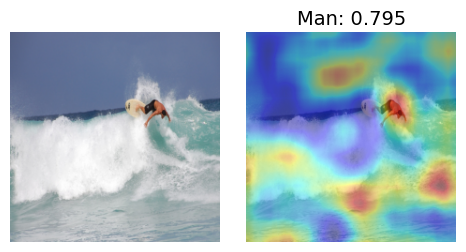

 26%|████████████████████▎                                                         | 98/376 [00:44<02:03,  2.25it/s]

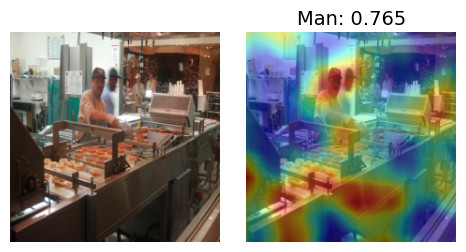

 26%|████████████████████▌                                                         | 99/376 [00:44<02:02,  2.27it/s]

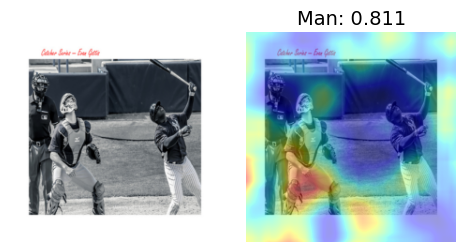

 27%|████████████████████▍                                                        | 100/376 [00:45<01:59,  2.31it/s]

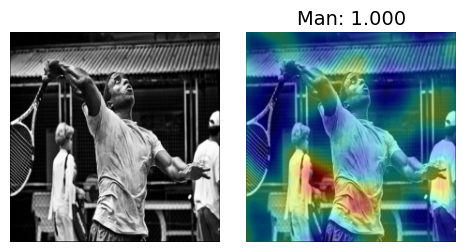

 27%|████████████████████▋                                                        | 101/376 [00:45<01:57,  2.34it/s]

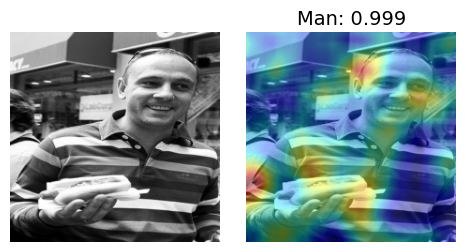

 27%|████████████████████▉                                                        | 102/376 [00:46<01:57,  2.34it/s]

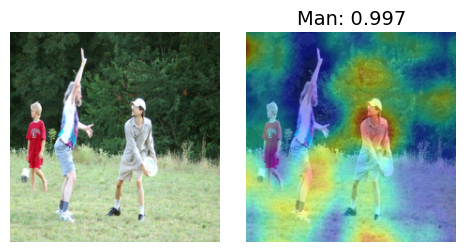

 27%|█████████████████████                                                        | 103/376 [00:46<01:57,  2.32it/s]

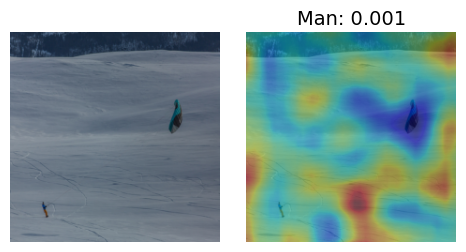

 28%|█████████████████████▎                                                       | 104/376 [00:46<01:58,  2.29it/s]

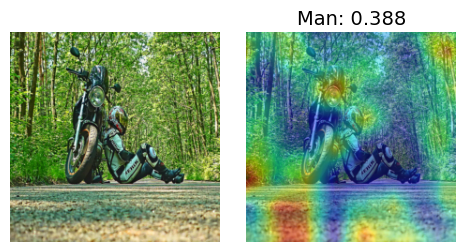

 28%|█████████████████████▌                                                       | 105/376 [00:47<01:58,  2.29it/s]

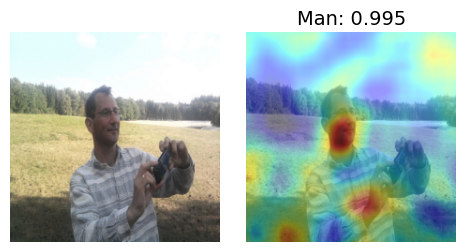

 28%|█████████████████████▋                                                       | 106/376 [00:47<01:58,  2.28it/s]

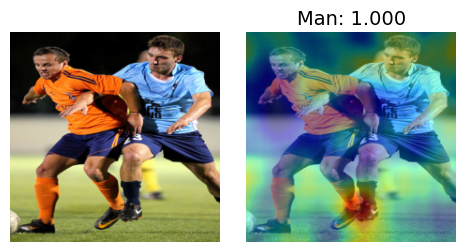

 28%|█████████████████████▉                                                       | 107/376 [00:48<01:58,  2.27it/s]

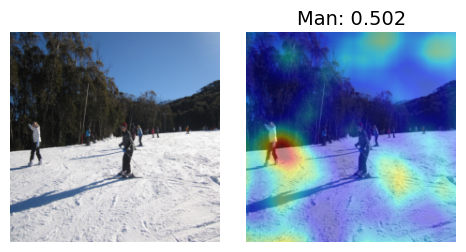

 29%|██████████████████████                                                       | 108/376 [00:48<01:58,  2.27it/s]

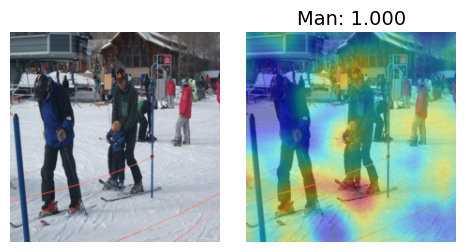

 29%|██████████████████████▎                                                      | 109/376 [00:49<01:58,  2.26it/s]

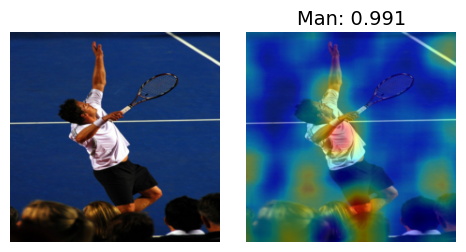

 29%|██████████████████████▌                                                      | 110/376 [00:49<01:58,  2.25it/s]

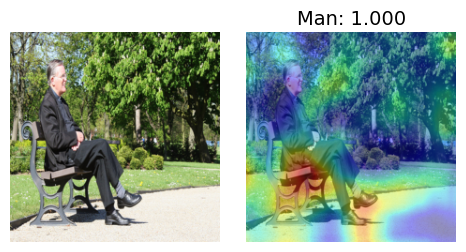

 30%|██████████████████████▋                                                      | 111/376 [00:50<01:57,  2.26it/s]

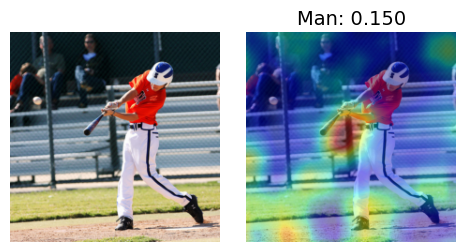

 30%|██████████████████████▉                                                      | 112/376 [00:50<01:57,  2.25it/s]

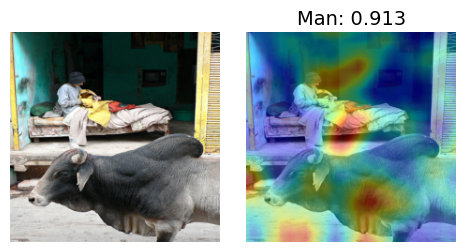

 30%|███████████████████████▏                                                     | 113/376 [00:50<01:57,  2.24it/s]

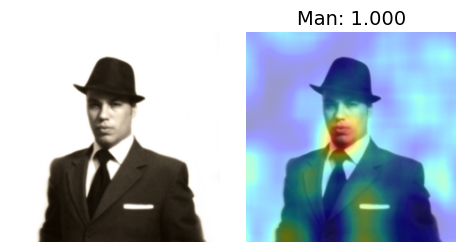

 30%|███████████████████████▎                                                     | 114/376 [00:51<01:54,  2.28it/s]

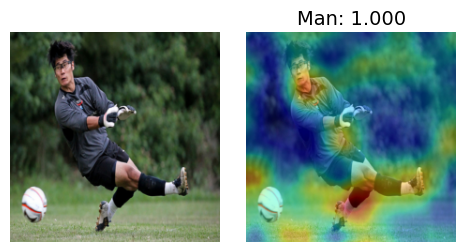

 31%|███████████████████████▌                                                     | 115/376 [00:51<01:55,  2.25it/s]

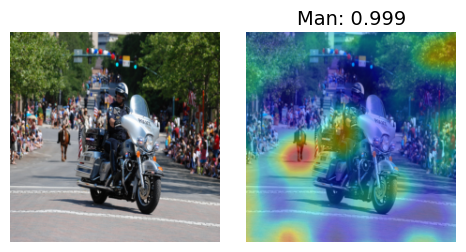

 31%|███████████████████████▊                                                     | 116/376 [00:52<01:55,  2.26it/s]

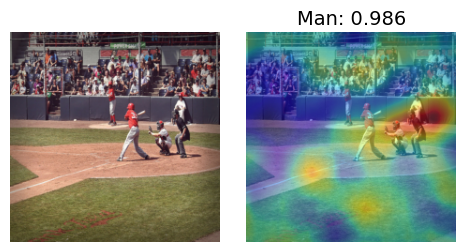

 31%|███████████████████████▉                                                     | 117/376 [00:52<01:54,  2.25it/s]

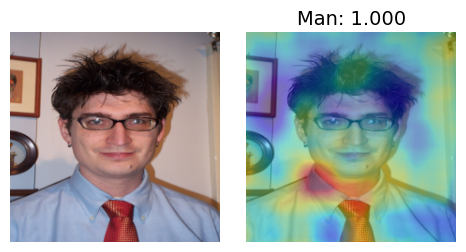

 31%|████████████████████████▏                                                    | 118/376 [00:53<01:55,  2.24it/s]

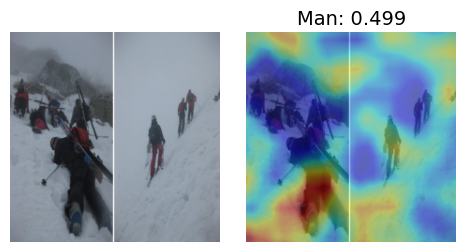

 32%|████████████████████████▎                                                    | 119/376 [00:53<01:53,  2.26it/s]

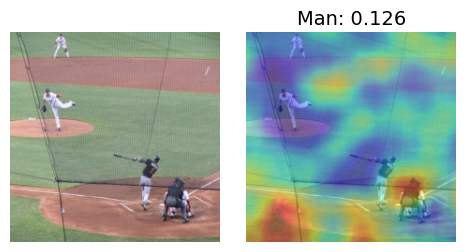

 32%|████████████████████████▌                                                    | 120/376 [00:54<01:54,  2.24it/s]

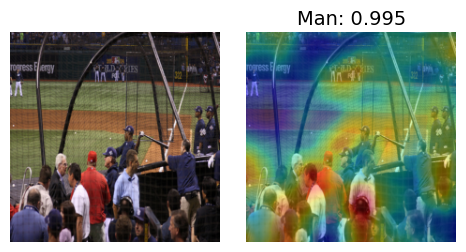

 32%|████████████████████████▊                                                    | 121/376 [00:54<01:53,  2.24it/s]

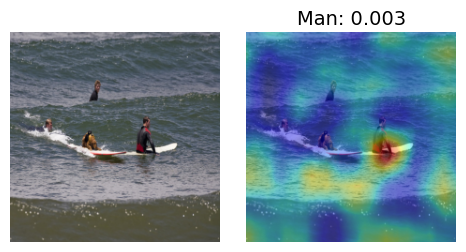

 32%|████████████████████████▉                                                    | 122/376 [00:54<01:53,  2.24it/s]

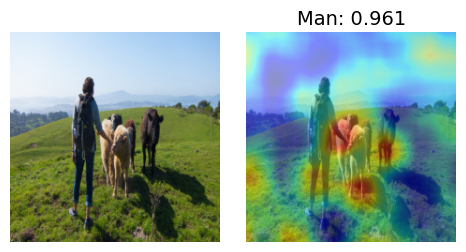

 33%|█████████████████████████▏                                                   | 123/376 [00:55<01:52,  2.24it/s]

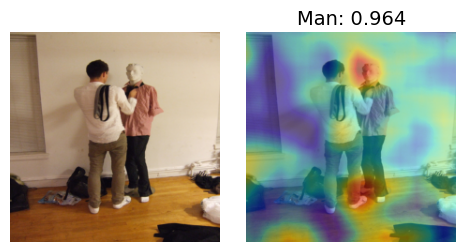

 33%|█████████████████████████▍                                                   | 124/376 [00:55<01:52,  2.24it/s]

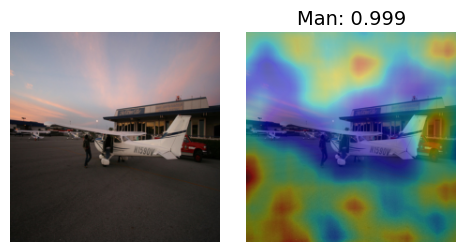

 33%|█████████████████████████▌                                                   | 125/376 [00:56<01:52,  2.24it/s]

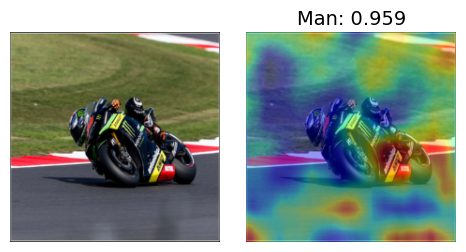

 34%|█████████████████████████▊                                                   | 126/376 [00:56<01:52,  2.23it/s]

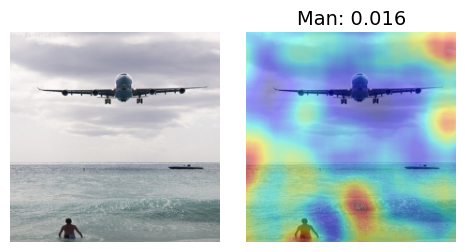

 34%|██████████████████████████                                                   | 127/376 [00:57<01:50,  2.26it/s]

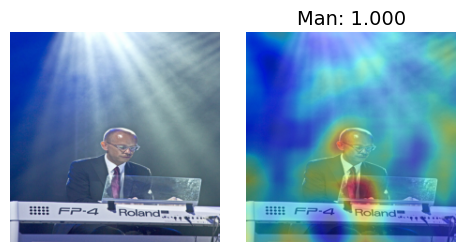

 34%|██████████████████████████▏                                                  | 128/376 [00:57<01:50,  2.24it/s]

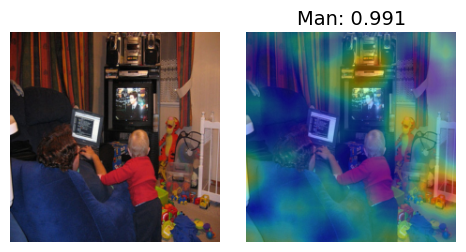

 34%|██████████████████████████▍                                                  | 129/376 [00:58<01:50,  2.23it/s]

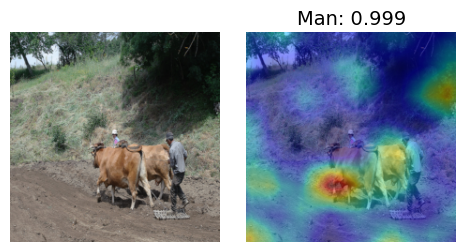

 35%|██████████████████████████▌                                                  | 130/376 [00:58<01:49,  2.24it/s]

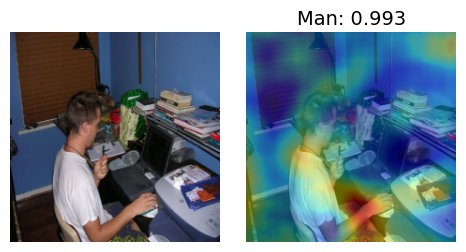

 35%|██████████████████████████▊                                                  | 131/376 [00:58<01:49,  2.24it/s]

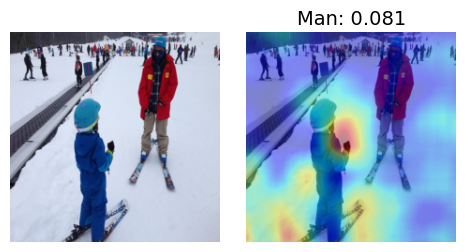

 35%|███████████████████████████                                                  | 132/376 [00:59<01:48,  2.25it/s]

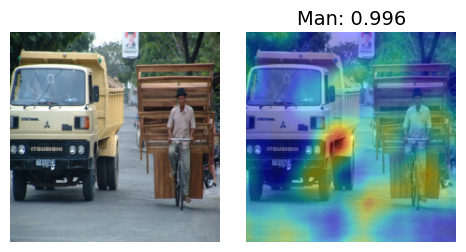

 35%|███████████████████████████▏                                                 | 133/376 [00:59<01:48,  2.24it/s]

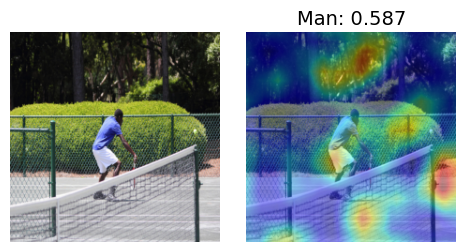

 36%|███████████████████████████▍                                                 | 134/376 [01:00<01:47,  2.25it/s]

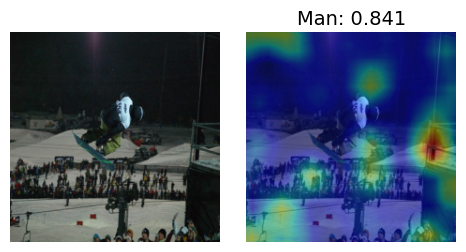

 36%|███████████████████████████▋                                                 | 135/376 [01:00<01:47,  2.25it/s]

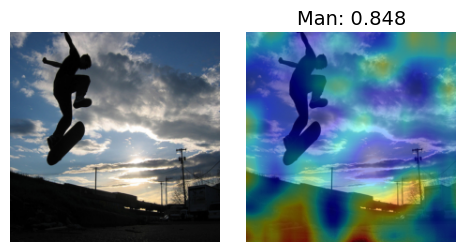

 36%|███████████████████████████▊                                                 | 136/376 [01:01<01:46,  2.24it/s]

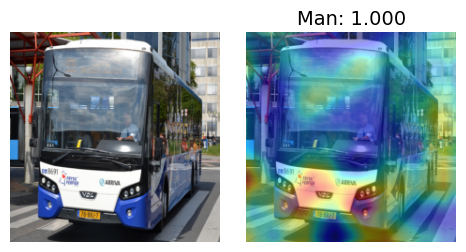

 36%|████████████████████████████                                                 | 137/376 [01:01<01:46,  2.25it/s]

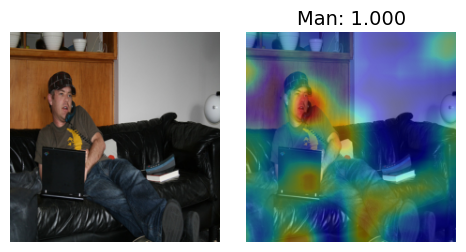

 37%|████████████████████████████▎                                                | 138/376 [01:02<01:45,  2.25it/s]

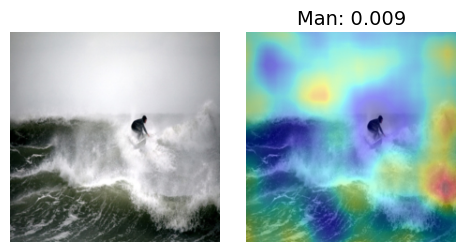

 37%|████████████████████████████▍                                                | 139/376 [01:02<01:45,  2.24it/s]

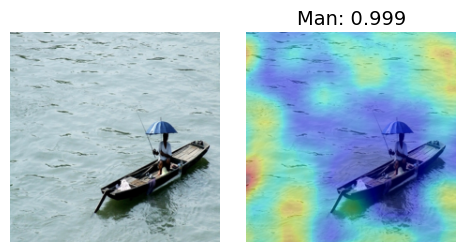

 37%|████████████████████████████▋                                                | 140/376 [01:02<01:45,  2.24it/s]

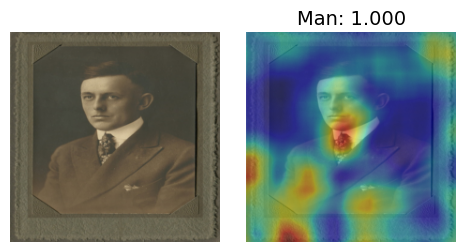

 38%|████████████████████████████▉                                                | 141/376 [01:03<01:45,  2.23it/s]

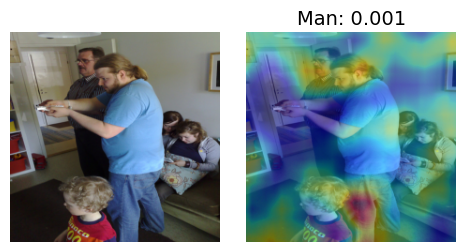

 38%|█████████████████████████████                                                | 142/376 [01:03<01:44,  2.23it/s]

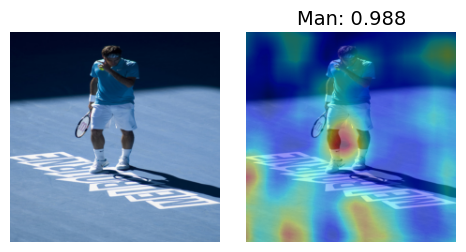

 38%|█████████████████████████████▎                                               | 143/376 [01:04<01:44,  2.24it/s]

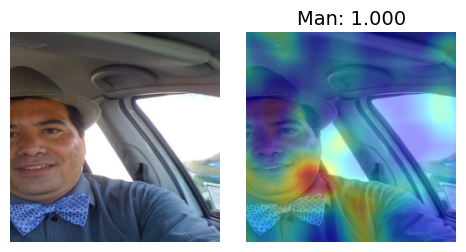

 38%|█████████████████████████████▍                                               | 144/376 [01:04<01:44,  2.23it/s]

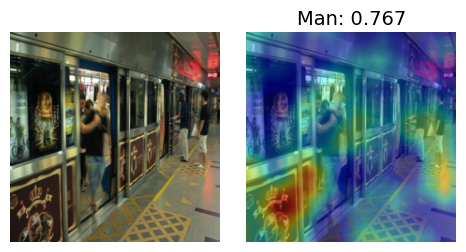

 39%|█████████████████████████████▋                                               | 145/376 [01:05<01:43,  2.23it/s]

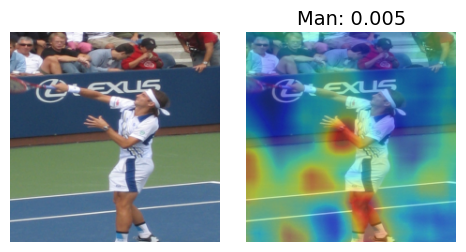

 39%|█████████████████████████████▉                                               | 146/376 [01:05<01:43,  2.23it/s]

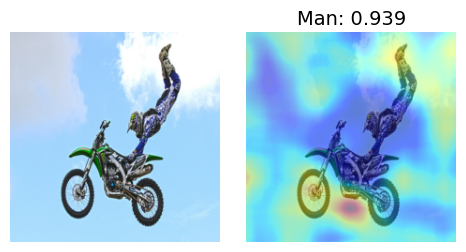

 39%|██████████████████████████████                                               | 147/376 [01:06<01:42,  2.24it/s]

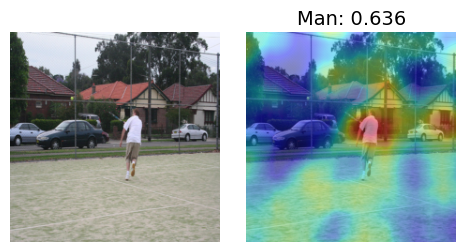

 39%|██████████████████████████████▎                                              | 148/376 [01:06<01:42,  2.23it/s]

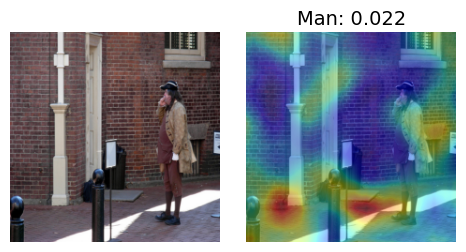

 40%|██████████████████████████████▌                                              | 149/376 [01:06<01:42,  2.22it/s]

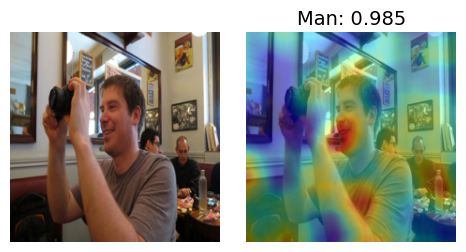

 40%|██████████████████████████████▋                                              | 150/376 [01:07<01:41,  2.22it/s]

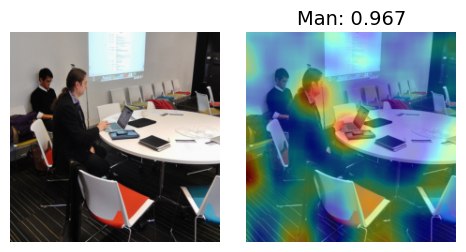

 40%|██████████████████████████████▉                                              | 151/376 [01:07<01:41,  2.22it/s]

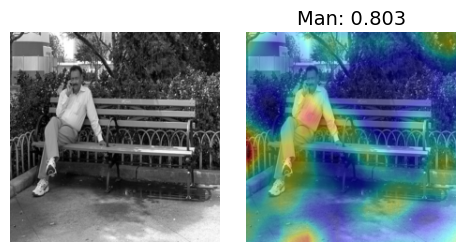

 40%|███████████████████████████████▏                                             | 152/376 [01:08<01:40,  2.24it/s]

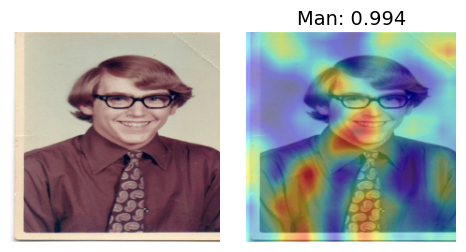

 41%|███████████████████████████████▎                                             | 153/376 [01:08<01:39,  2.24it/s]

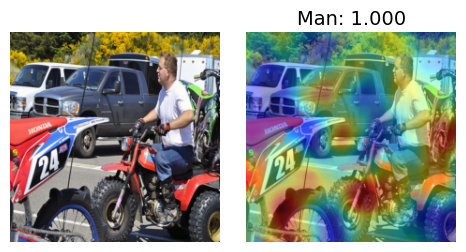

 41%|███████████████████████████████▌                                             | 154/376 [01:09<01:38,  2.24it/s]

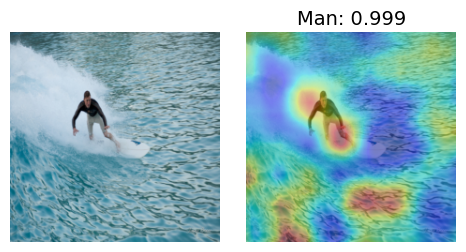

 41%|███████████████████████████████▋                                             | 155/376 [01:10<02:08,  1.72it/s]

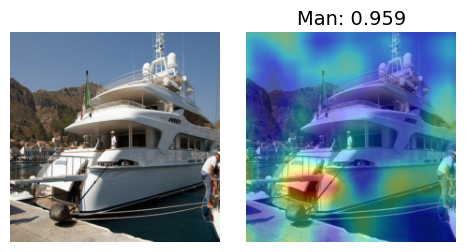

 41%|███████████████████████████████▉                                             | 156/376 [01:10<01:58,  1.85it/s]

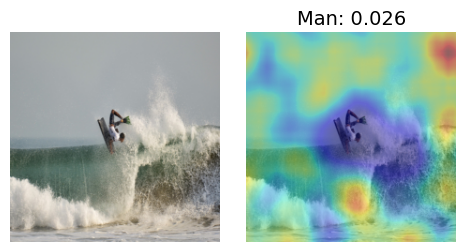

 42%|████████████████████████████████▏                                            | 157/376 [01:11<01:51,  1.96it/s]

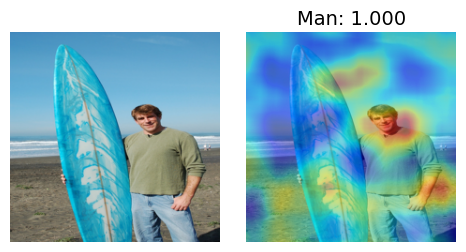

 42%|████████████████████████████████▎                                            | 158/376 [01:11<01:47,  2.03it/s]

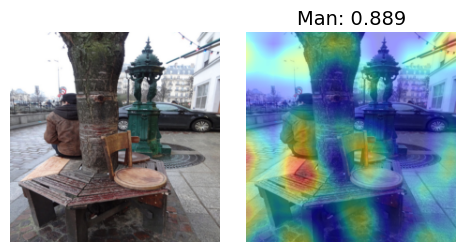

 42%|████████████████████████████████▌                                            | 159/376 [01:11<01:43,  2.10it/s]

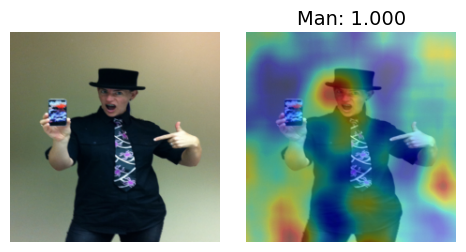

 43%|████████████████████████████████▊                                            | 160/376 [01:12<01:41,  2.13it/s]

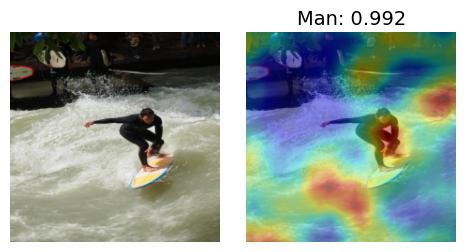

 43%|████████████████████████████████▉                                            | 161/376 [01:12<01:39,  2.16it/s]

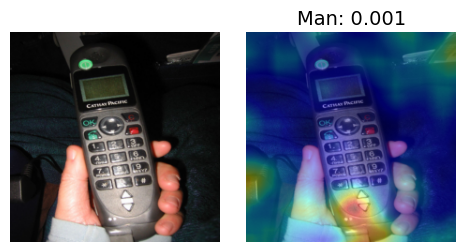

 43%|█████████████████████████████████▏                                           | 162/376 [01:13<01:37,  2.19it/s]

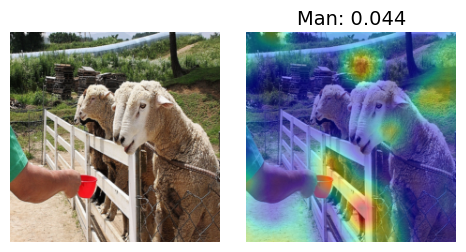

 43%|█████████████████████████████████▍                                           | 163/376 [01:13<01:36,  2.20it/s]

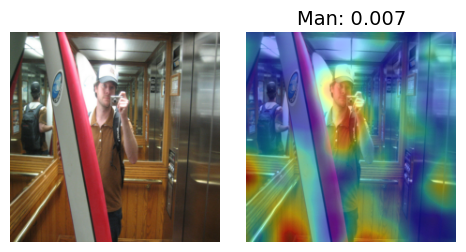

 44%|█████████████████████████████████▌                                           | 164/376 [01:14<01:36,  2.19it/s]

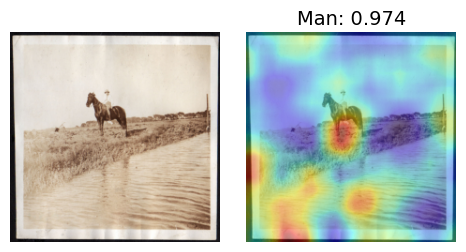

 44%|█████████████████████████████████▊                                           | 165/376 [01:14<01:36,  2.19it/s]

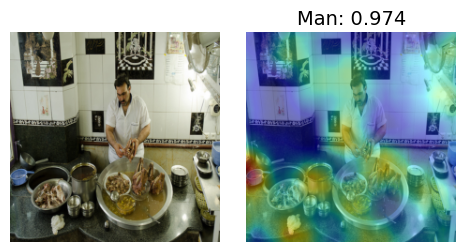

 44%|█████████████████████████████████▉                                           | 166/376 [01:15<01:36,  2.19it/s]

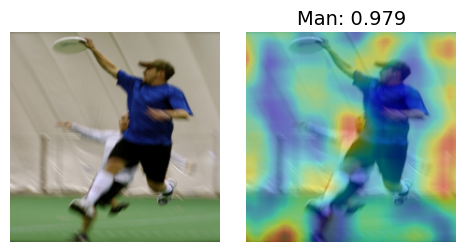

 44%|██████████████████████████████████▏                                          | 167/376 [01:15<01:35,  2.20it/s]

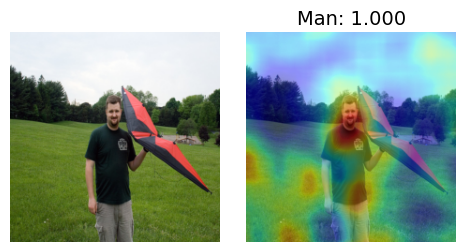

 45%|██████████████████████████████████▍                                          | 168/376 [01:15<01:34,  2.21it/s]

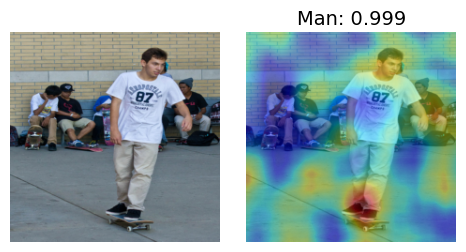

 45%|██████████████████████████████████▌                                          | 169/376 [01:16<01:33,  2.21it/s]

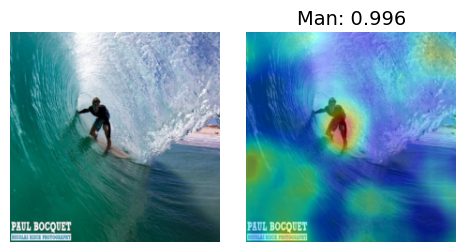

 45%|██████████████████████████████████▊                                          | 170/376 [01:16<01:33,  2.21it/s]

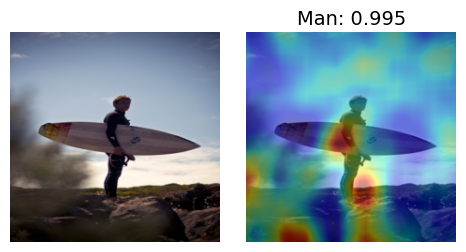

 45%|███████████████████████████████████                                          | 171/376 [01:17<01:31,  2.23it/s]

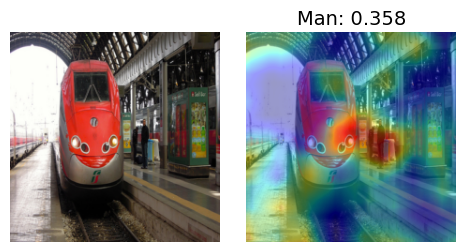

 46%|███████████████████████████████████▏                                         | 172/376 [01:17<01:30,  2.25it/s]

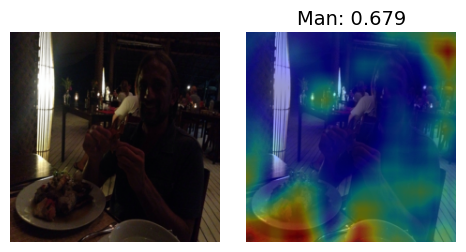

 46%|███████████████████████████████████▍                                         | 173/376 [01:18<01:30,  2.25it/s]

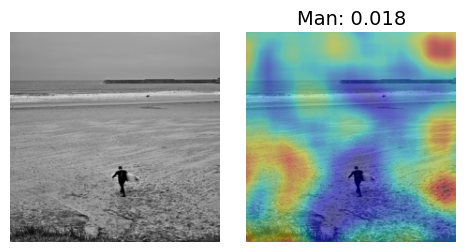

 46%|███████████████████████████████████▋                                         | 174/376 [01:18<01:30,  2.22it/s]

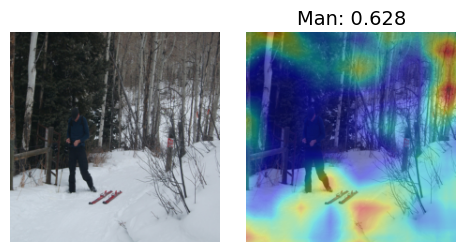

 47%|███████████████████████████████████▊                                         | 175/376 [01:19<01:30,  2.22it/s]

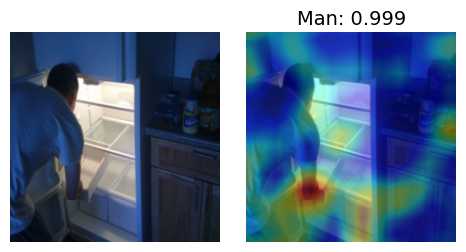

 47%|████████████████████████████████████                                         | 176/376 [01:19<01:30,  2.21it/s]

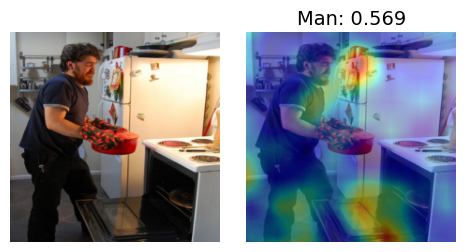

 47%|████████████████████████████████████▏                                        | 177/376 [01:19<01:28,  2.24it/s]

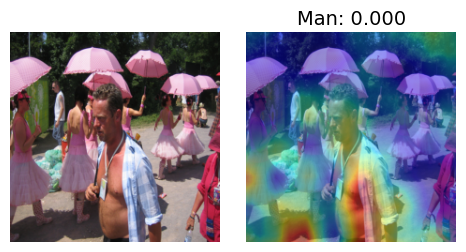

 47%|████████████████████████████████████▍                                        | 178/376 [01:20<01:27,  2.25it/s]

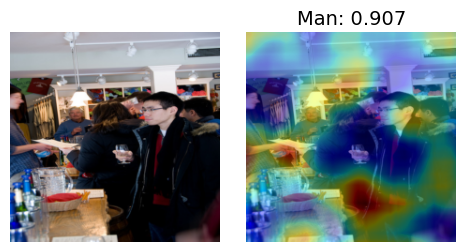

 48%|████████████████████████████████████▋                                        | 179/376 [01:20<01:26,  2.28it/s]

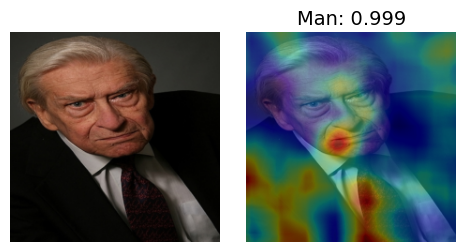

 48%|████████████████████████████████████▊                                        | 180/376 [01:21<01:26,  2.28it/s]

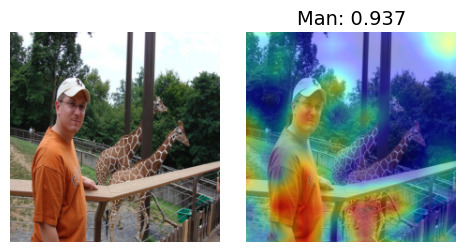

 48%|█████████████████████████████████████                                        | 181/376 [01:21<01:25,  2.27it/s]

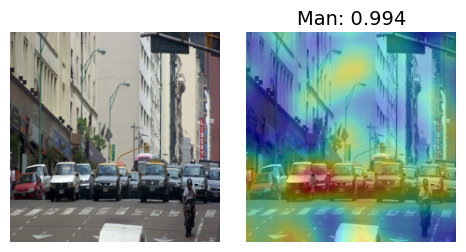

 48%|█████████████████████████████████████▎                                       | 182/376 [01:22<01:26,  2.25it/s]

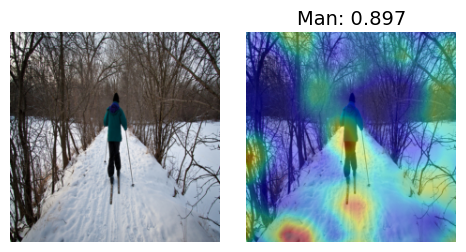

 49%|█████████████████████████████████████▍                                       | 183/376 [01:22<01:25,  2.25it/s]

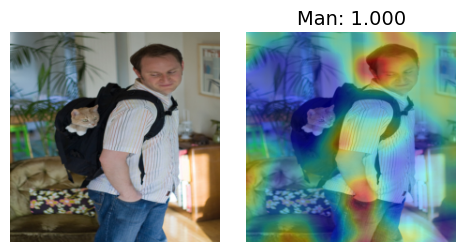

 49%|█████████████████████████████████████▋                                       | 184/376 [01:23<01:25,  2.24it/s]

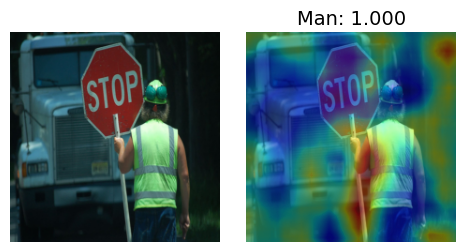

 49%|█████████████████████████████████████▉                                       | 185/376 [01:23<01:25,  2.23it/s]

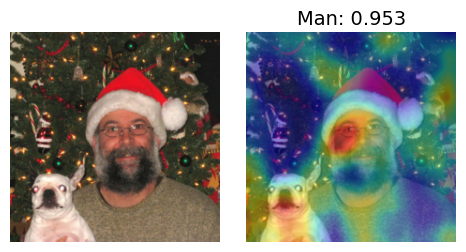

 49%|██████████████████████████████████████                                       | 186/376 [01:23<01:25,  2.23it/s]

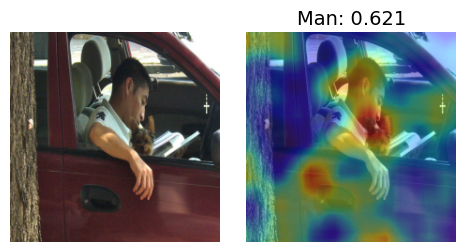

 50%|██████████████████████████████████████▎                                      | 187/376 [01:24<01:25,  2.21it/s]

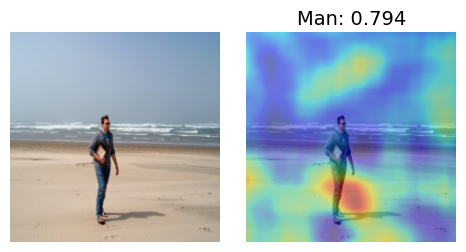

 50%|██████████████████████████████████████▌                                      | 188/376 [01:24<01:25,  2.21it/s]

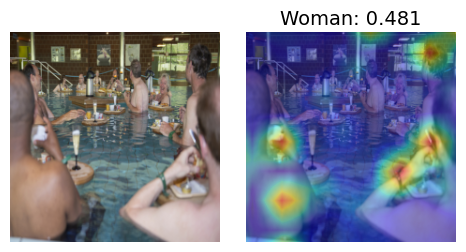

 50%|██████████████████████████████████████▋                                      | 189/376 [01:25<01:24,  2.21it/s]

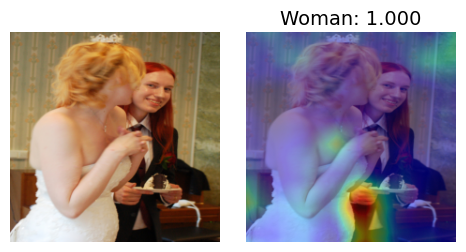

 51%|██████████████████████████████████████▉                                      | 190/376 [01:25<01:24,  2.20it/s]

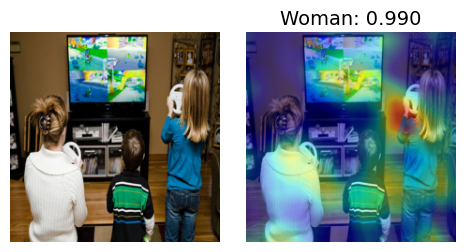

 51%|██████████████████████████████████████▉                                      | 190/376 [01:26<01:24,  2.20it/s]


In [38]:
net.eval()
torch.set_grad_enabled(False)
for i, batch in enumerate(tqdm(test_dataloader)):
    inputs, labels = batch['image'].to(device), batch['label'].to(device)
    
    img_path = batch['image_path'][0]
    pil_image =  transforms.Resize((size, size))(Image.open(img_path).convert('RGB'))
    numpy_image = np.array(pil_image)
    
    saliencies = rise(inputs)
    
   # logits  = net(inputs) # 1 x num_classes
    probs = net(inputs)
    model_out = explain_all(inputs, labels, net)[1]
    
    prob_float = float(probs[0][labels[0].long()].cpu())
    label_float = float(labels[0])
#     print(labels)
#     break
    sample_sal = saliencies[labels[0].long()].cpu().numpy() # 224 x 224
    
    
    plot(numpy_image,
         label_float,
         prob_float,
         sample_sal,
         label_mapping=label_mapping,
         save_path=None
    )
    
    if i == 190:
        break


        



In [17]:
out.shape


torch.Size([1000, 224, 224])

In [18]:
labels

tensor([1.], device='cuda:2')

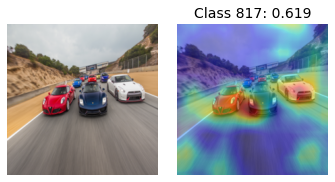

In [13]:
torch.set_grad_enabled(False)

mean, std = normalizations.normalizations['imagenet']['mean'], \
            normalizations.normalizations['imagenet']['std']
transform = transforms.Compose([
    transforms.Resize((size, size)),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

img_path = 'sample_ims/cars.jpg'
pil_image =  transforms.Resize((size, size))(Image.open(img_path).convert('RGB'))
numpy_image = np.array(pil_image)

img = transform(pil_image).unsqueeze(0).to(device)


saliencies = rise(img)

probs  = net(img) # 1 x num_classes
pred_class = torch.where(probs == torch.max(probs))[1].item()


prob_float = float(probs[0][pred_class].cpu())
label_float = float(pred_class)

sample_sal = saliencies[pred_class].cpu().numpy() # 224 x 224

plot(numpy_image,
     label_float,
     prob_float,
     sample_sal,
     label_mapping=None,
     save_path=None
)

